<a href="https://colab.research.google.com/github/p4arth/NLP/blob/main/ImageColourizer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import numpy as np
import cv2

In [4]:
ppath = '/content/drive/MyDrive/colorization_deploy_v2.prototxt'
mp = '/content/drive/MyDrive/colorization_release_v2.caffemodel'
kpath = '/content/drive/MyDrive/pts_in_hull.npy'
ipath = '/content/drive/MyDrive/ramin-talebi-rFRfxVM606s-unsplash.jpg'

In [5]:
net = cv2.dnn.readNetFromCaffe(ppath,mp)
pt = np.load(kpath)

In [15]:
pt = pt.transpose().reshape(2,313,1,1)
net.getLayer(net.getLayerId('class8_ab')).blobs = [pt.astype(np.float32)]
net.getLayer(net.getLayerId('conv8_313_rh')).blobs = [np.full([1,313], 2.606, dtype='float32')]

In [16]:
bwi = cv2.imread(ipath)
normal = bwi.astype('float32') / 255.0
lab = cv2.cvtColor(normal,cv2.COLOR_BGR2LAB)

In [18]:
re = cv2.resize(lab,(224,224))
l = cv2.split(re)[0]
l -= 50

In [19]:
net.setInput(cv2.dnn.blobFromImage(l))
ab = net.forward()[0,:,:,:].transpose((1,2,0))

In [21]:
ab = cv2.resize(ab,(bwi.shape[1],bwi.shape[0]))
l = cv2.split(lab)[0]

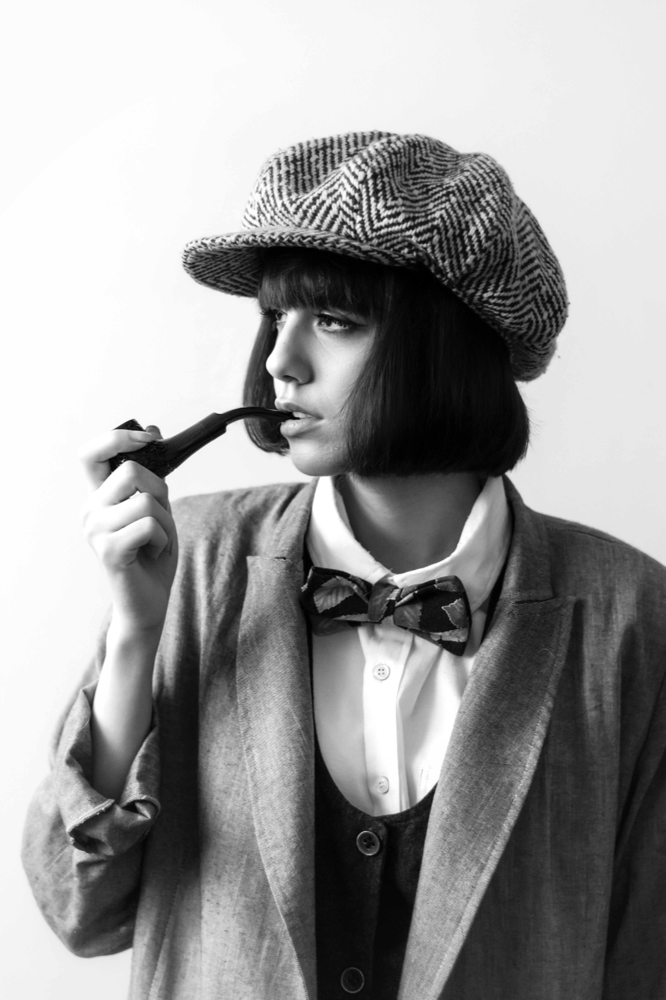

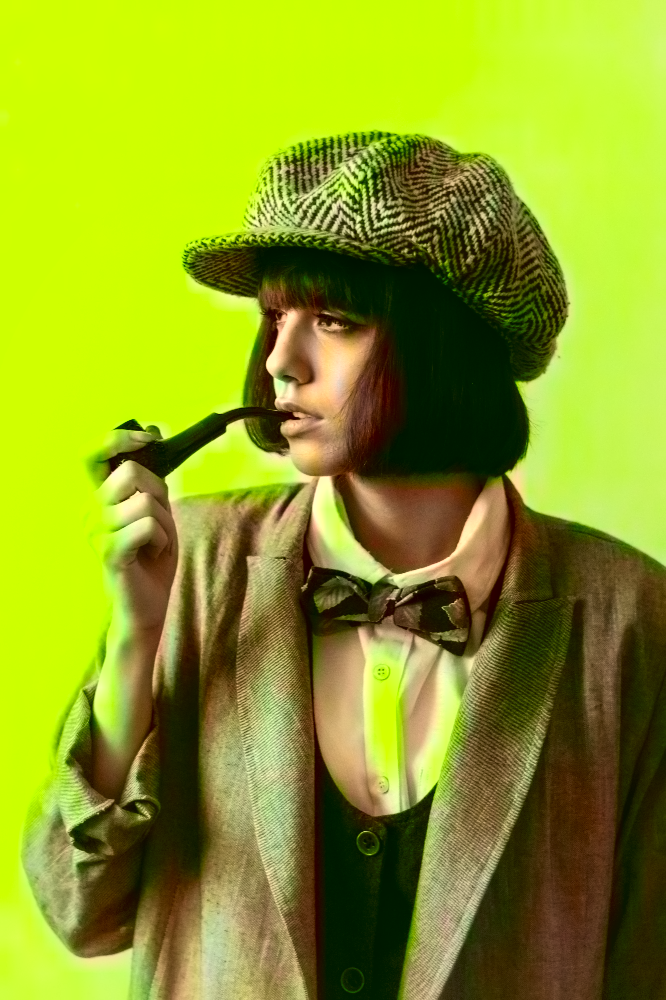

In [32]:
clr = np.concatenate((l[:,:,np.newaxis],ab),axis=2)
clr = cv2.cvtColor(clr,cv2.COLOR_LAB2BGR)
clr = (255.0 * clr).astype('uint8')
cv2_imshow(bwi)
cv2_imshow(clr)
cv2.waitKey(0)
cv2.destroyAllWindows()

In [24]:
from google.colab.patches import cv2_imshow

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  4534  100  4534    0     0   122k      0 --:--:-- --:--:-- --:--:--  122k


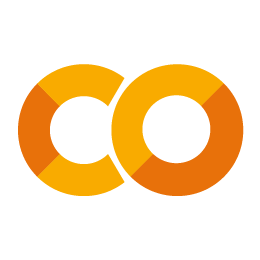

In [25]:
!curl -o logo.png https://colab.research.google.com/img/colab_favicon_256px.png
import cv2
img = cv2.imread('logo.png', cv2.IMREAD_UNCHANGED)
cv2_imshow(img)